<a href="https://colab.research.google.com/github/surya81/multiple-object-detection-using-Dectron-2/blob/main/multiple_object_detection_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -qU openimages torch_snippets

     |████████████████████████████████| 49 kB 5.6 MB/s 
     |████████████████████████████████| 49 kB 6.5 MB/s 
     |████████████████████████████████| 132 kB 62.8 MB/s 
     |████████████████████████████████| 948 kB 71.1 MB/s 
     |████████████████████████████████| 58 kB 5.4 MB/s 
     |████████████████████████████████| 235 kB 74.8 MB/s 
     |████████████████████████████████| 78 kB 6.5 MB/s 
     |████████████████████████████████| 79 kB 8.1 MB/s 
     |████████████████████████████████| 9.0 MB 46.6 MB/s 
     |████████████████████████████████| 139 kB 75.2 MB/s 
     |████████████████████████████████| 207.4 MB 69 kB/s 
     |████████████████████████████████| 812 kB 51.7 MB/s 
     |████████████████████████████████| 5.8 MB 45.4 MB/s 
     |████████████████████████████████| 438 kB 74.1 MB/s 
     |████████████████████████████████| 1.6 MB 57.7 MB/s 
     |████████████████████████████████| 127 kB 62.4 MB/s 
     |████████████████████████████████| 51 kB 8.0 MB/s 
ERROR: pip's dependency re

In [2]:
from torch_snippets import *
!wget -O train-annotations-object-segmentation.csv -q https://storage.googleapis.com/openimages/v5/train-annotations-object-segmentation.csv
!wget -O classes.csv -q https://raw.githubusercontent.com/openimages/dataset/master/dict.csv

In [3]:
required_classes = 'person,dog,bird,zar,elephants,football,jug,laptop,Mushroom,Pizza,Rocket,Shirt,TrafficSign,Watermelon,Zebra'

In [4]:
required_classes = [c.lower() for c in required_classes.lower().split(',') ]

In [5]:
classes = pd.read_csv('classes.csv',header = None)

In [6]:
classes

,0,1
0,/g/1172hxxrk,traditional sport
1,/g/11jwzh3_l,volcanic landform
2,/g/11jxkqbpp,mountainous landforms
3,/g/11jy976z6,small terrier
4,/g/11k2xz7mr,meteorological phenomenon
...,...,...
7876,/m/0z74,australian rules football
7877,/m/0zg7256,gingerbread house
7878,/m/0zkm,arthropod
7879,/m/0zrpfhj,throwing


In [7]:
classes.columns = ['class','class_name']
classes

,class,class_name
0,/g/1172hxxrk,traditional sport
1,/g/11jwzh3_l,volcanic landform
2,/g/11jxkqbpp,mountainous landforms
3,/g/11jy976z6,small terrier
4,/g/11k2xz7mr,meteorological phenomenon
...,...,...
7876,/m/0z74,australian rules football
7877,/m/0zg7256,gingerbread house
7878,/m/0zkm,arthropod
7879,/m/0zrpfhj,throwing


In [8]:
classes= classes[classes['class_name'].map (lambda x:x in required_classes)]
classes

,class,class_name
43,/m/01226z,football
224,/m/015p6,bird
601,/m/01c648,laptop
753,/m/01g317,person
1045,/m/01n4qj,shirt
2819,/m/02vx4,football
4675,/m/052sf,mushroom
5181,/m/0663v,pizza
5916,/m/0898b,zebra
5952,/m/08hvt4,jug


In [9]:
df = pd.read_csv('/content/train-annotations-object-segmentation.csv')

In [10]:
df.shape

(2686666, 10)

In [11]:
data = pd.merge(df,classes,left_on = 'LabelName',right_on = 'class')
print(data.shape)

(220118, 12)


In [12]:
subset_data = data.groupby('class_name').agg({'ImageID':lambda x :list(x)[:500]})
subset_data

,ImageID
class_name,
bird,"[09991c4d538fb114, 3ee4d07305d7a5df, b1270151a..."
dog,"[871991d5e1d800a5, 0abe18d0e7f90ff7, b2bf2314f..."
football,"[11bac049d17ba74a, d008a1adda83788a, 27f7d9734..."
jug,"[0cf674ed54067a01, 03e1179702721883, 8844c5d38..."
laptop,"[7c29c3feb9db0ab8, 99b4183340d82807, f3807e63d..."
mushroom,"[9a00d1c3a682c068, 16cfab25fdbe54de, b3691afad..."
person,"[e9a7da5ff1fd56df, 18c1fd8342d55af8, 42ea7face..."
pizza,"[19c952065cb9928e, 6c26f20ac6ef4718, 2bd7c9e79..."
rocket,"[0e6557b3b8028471, 596d2e35e8882c69, 050097fd1..."


In [13]:
subset_data = flatten(subset_data.ImageID.tolist())
subset_data

['09991c4d538fb114',
 '3ee4d07305d7a5df',
 'b1270151a9721787',
 'a4b6dc42a3d67077',
 '5408a31967ad3423',
 '22a999e82bd49d37',
 'f12bc6b53bade27f',
 '06c66e63cffa6510',
 '4cb3cc91f46ae4b8',
 '166887fad15a9724',
 'af0539faeda249f0',
 'b73056eabfec4ca8',
 '8369056114bb7f7d',
 '6fd26dedacdebd8b',
 '6d95c2c0952098e4',
 '9727de1216c57cf4',
 '93a629a97ece526e',
 '07a51580f52eeae8',
 '2c2e0641a4453e5c',
 '01371b66507528f8',
 'ee05932a2f6ec02a',
 'a36566e87fd5f86d',
 '8e27e5ac342f692b',
 '204b6777fa1a5d2a',
 '2ea881fd40af5f2d',
 '2bc315fcdb2ca9ee',
 '1d0a7f39464905c5',
 '7963cdc450fc401b',
 'c1e22269747caa90',
 'e84f1d5527734208',
 'c741f5db8f121155',
 'e33ff24764120264',
 '4176eaf2c991e791',
 '55dd38fddcd65cc1',
 '7f174c07f623ba89',
 'ddc7200e0803333f',
 '53a144b1ebd2356b',
 '4cb3cc91f46ae4b8',
 '60ccd324d6d410f2',
 '5ff3c34b9ce5373f',
 '8c5ee38fb230c7b4',
 'd241a4992f90f760',
 '5ed03b0a3c3ccce8',
 '374c006d69959a6e',
 '7963cdc450fc401b',
 '2275da8c0d41978f',
 'ec67ff4953518f79',
 '5505bd0c1d9

In [14]:
subset_data = data[data['ImageID'].map(lambda x :  x in subset_data)]
subset_data


,MaskPath,ImageID,LabelName,BoxID,BoxXMin,BoxXMax,BoxYMin,BoxYMax,PredictedIoU,Clicks,class,class_name
0,e9a7da5ff1fd56df_m01g317_1803811b.png,e9a7da5ff1fd56df,/m/01g317,1803811b,0.468125,0.628750,0.188714,0.949121,0.86841,0.47513 0.38255 1;0.52118 0.91333 0;0.47513 0....,/m/01g317,person
1,18c1fd8342d55af8_m01g317_a9a97702.png,18c1fd8342d55af8,/m/01g317,a9a97702,0.394375,0.605000,0.241667,0.903333,0.81242,0.57036 0.81358 1;0.54599 0.65655 0;0.42280 0....,/m/01g317,person
2,42ea7facefea9a28_m01g317_333376e6.png,42ea7facefea9a28,/m/01g317,333376e6,0.791875,0.839375,0.096226,0.184906,0.64984,0.79876 0.17372 1;0.84756 0.19868 1;0.80936 0....,/m/01g317,person
3,bcb123bf7f256b1c_m01g317_a42b01bc.png,bcb123bf7f256b1c,/m/01g317,a42b01bc,0.478125,0.518750,0.450797,0.604499,0.77027,0.49924 0.57654 0;0.50731 0.45367 1;0.49108 0....,/m/01g317,person
4,a2bb5944e071223c_m01g317_7ef4ab8d.png,a2bb5944e071223c,/m/01g317,7ef4ab8d,0.738750,0.861250,0.508333,0.631667,0.71815,0.79186 0.54778 0;0.80219 0.52627 1;0.84317 0....,/m/01g317,person
...,...,...,...,...,...,...,...,...,...,...,...,...
220110,247e2e3105a7b81a_m08hvt4_b3c50d64.png,247e2e3105a7b81a,/m/08hvt4,b3c50d64,0.398750,0.456250,0.539167,0.640000,0.92938,0.40392 0.56714 0;0.40246 0.57741 1;0.45561 0....,/m/08hvt4,jug
220113,19b9b7acfefbd162_m08hvt4_1682655d.png,19b9b7acfefbd162,/m/08hvt4,1682655d,0.631250,0.928750,0.296667,0.802500,0.90699,0.91454 0.35031 0;0.92895 0.53163 0;0.93898 0....,/m/08hvt4,jug
220114,7d9fd88b2699cc6d_m08hvt4_d785dbd9.png,7d9fd88b2699cc6d,/m/08hvt4,d785dbd9,0.513125,0.659375,0.298311,0.608818,0.81158,0.65518 0.33896 1;0.62441 0.44468 0;0.65074 0....,/m/08hvt4,jug
220115,1c5f7fc01eea9b1a_m08hvt4_2f96d800.png,1c5f7fc01eea9b1a,/m/08hvt4,2f96d800,0.355000,0.511250,0.579737,0.881801,0.84473,0.46071 0.64206 1;0.50700 0.64289 1;0.37250 0....,/m/08hvt4,jug


In [15]:
subset_masks = subset_data['MaskPath'].tolist()

In [16]:
!mkdir -p masks
for c in Tqdm('0123456789abcdef'):
            !wget -q https://storage.googleapis.com/openimages/v5/train-masks/train-masks-{c}.zip
            !unzip -q train-masks-{c}.zip -d tmp_masks
            !rm train-masks-{c}.zip
            tmp_masks = Glob('tmp_masks', silent=True)
            items = [(m,fname(m)) for m in tmp_masks]
            items = [(i,j) for (i,j) in items if j in subset_masks]
            for i,j in items:
              os.rename(i, f'masks/{j}')
            !rm -rf tmp_masks

100%|██████████| 16/16 [22:48<00:00, 85.56s/it]


#Open Images has 16 ZIP files for training masks. Each ZIP file
will have only a few masks from subset_masks, so we will delete the rest after moving the required masks into a separate folder

#Download the images corresponding to ImageId

In [17]:
masks = Glob('masks')
masks = [fname(mask) for mask in masks]
subset_data = subset_data[subset_data['MaskPath'].map(lambda x: x in masks)]
subset_imageIds = subset_data['ImageID'].tolist()
from openimages.download import _download_images_by_id
!mkdir images
_download_images_by_id(subset_imageIds,'train','./images/')

100%|██████████| 11674/11674 [01:34<00:00, 122.96it/s]


In [18]:
import zipfile
files = Glob('images') + Glob('masks') + ['train-annotations-object-segmentation.csv', 'classes.csv']
with zipfile.ZipFile('data.zip','w') as zipme:
  for file in Tqdm(files):
    zipme.write(file, compress_type=zipfile.ZIP_DEFLATED)

100%|██████████| 16729/16729 [02:16<00:00, 122.34it/s]


In [19]:
!mkdir -p train/
!mv images train/myData2022
!mv masks train/annotations

In [20]:
!pip install git+http://github.com/waspinator/pycococreator.git@0.2.0
import datetime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning http://github.com/waspinator/pycococreator.git (to revision 0.2.0) to /tmp/pip-req-build-hi_8fk1l
  Running command git clone -q http://github.com/waspinator/pycococreator.git /tmp/pip-req-build-hi_8fk1l
  Running command git checkout -q fba8f4098f3c7aaa05fe119dc93bbe4063afdab8
  Created wheel for pycococreatortools: filename=pycococreatortools-0.2.0-py3-none-any.whl size=7204 sha256=21c5315dbf4af58d426fa8a8bf870a33253ec8201036d84463eab1a041c7c5d8
  Stored in directory: /tmp/pip-ephem-wheel-cache-cn4vtmso/wheels/8c/c4/78/f03f947481461f0b32068548682dcd223403e151fc4b2fb75b
Successfully built pycococreatortools


In [21]:
INFO = {
"description": "MyData2022",
"url": "None",
"version": "1.0",
"year": 2022,
"contributor": "surya",
"date_created": datetime.datetime.utcnow().isoformat(' ')
}

In [22]:
LICENSES = [
{
"id": 1,
"name": "MIT"
}
]

In [23]:
CATEGORIES = [{'id': id+1, 'name': name.replace('/',''), \
'supercategory': 'none'} \
for id,(_,(name, clss_name)) in \
enumerate(classes.iterrows())]

In [24]:
!pip install pycocotools
from pycococreatortools import pycococreatortools
from os import listdir
from os.path import isfile, join
from PIL import Image

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [25]:
coco_output = {
"info": INFO,
"licenses": LICENSES,
"categories": CATEGORIES,
"images": [],
"annotations": []
}

In [26]:
ROOT_DIR = "train"
IMAGE_DIR, ANNOTATION_DIR = 'train/myData2022/', 'train/annotations/'
image_files = [f for f in listdir(IMAGE_DIR) if isfile(join(IMAGE_DIR, f))]
annotation_files = [f for f in listdir(ANNOTATION_DIR) if isfile(join(ANNOTATION_DIR, f))]

In [27]:
image_id = 1
# go through each image
for image_filename in Tqdm(image_files):
  image = Image.open(IMAGE_DIR + '/' + image_filename)
  image_info = pycococreatortools.create_image_info(image_id, os.path.basename(image_filename), image.size)
  coco_output["images"].append(image_info)
  image_id = image_id + 1

100%|██████████| 5053/5053 [00:03<00:00, 1505.72it/s]


In [28]:
segmentation_id = 1
for annotation_filename in Tqdm(annotation_files):
  image_id = [f for f in coco_output['images'] if stem(f['file_name']) == annotation_filename.split('_')[0]][0]['id']
  class_id = [x['id'] for x in CATEGORIES if x['name'] in annotation_filename][0]
  category_info = {'id': class_id, 'is_crowd': 'crowd' in image_filename}
  binary_mask = np.asarray(Image.open(f'{ANNOTATION_DIR}/{annotation_filename}').convert('1')).astype(np.uint8)
  annotation_info = pycococreatortools.create_annotation_info( segmentation_id, image_id, category_info,binary_mask, image.size, tolerance=2)
  if annotation_info is not None:
    coco_output["annotations"].append(annotation_info)
    segmentation_id = segmentation_id + 1

100%|██████████| 11674/11674 [12:34<00:00, 15.47it/s]


In [29]:
coco_output['categories'] = [{'id': id+1, 'name':clss_name, 'supercategory': 'none'} for id,(_,(name, clss_name)) in enumerate(classes.iterrows())]

In [30]:
import json
with open('images.json', 'w') as output_json_file:
  json.dump(coco_output, output_json_file)

In [32]:
!python -m pip install pyyaml==5.1
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 28.0 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=33549250501f730b5e17da0d7af99b7efae0a48b0d7873f5727169c745039fbc
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-6aas5yen
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-6aas5yen
     |████████████████████████████████| 50 kB 7.0 MB/s 
     |████████████████████████████████| 79 kB

In [34]:
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg 
from detectron2.utils.visualizer import Visualizer 
from detectron2.data import MetadataCatalog,DatasetCatalog
from detectron2.engine import DefaultTrainer


In [35]:
from torch_snippets import *
required_classes= 'person,dog,bird,car,elephant,football,jug,laptop,Mushroom,Pizza,Rocket,Shirt,Traffic sign,Watermelon,Zebra'
required_classes = [c.lower() for c in required_classes.lower().split(',')]
classes = pd.read_csv('classes.csv', header=None)
classes.columns = ['class','class_name']
classes = classes[classes['class_name'].map(lambda x: x in required_classes)]

In [36]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("datasets_train", {}, "images.json", "train/myData2022")

In [37]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-\
InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("datasets_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-\
InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml") # pretrained
# weights
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025 # pick a good LR
cfg.SOLVER.MAX_ITER = 5000 # instead of epochs, we train on
# 5000 batches
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(classes)

In [38]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

2022-07-26  12:33:38 INFO Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2): Sequent

In [39]:
!cp output/model_final.pth output/trained_model.pth

In [40]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "trained_model.pth")

In [41]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.25

In [42]:
predictor = DefaultPredictor(cfg)

2022-07-26  13:15:24 INFO [Checkpointer] Loading from ./output/trained_model.pth ...
2022-07-26  13:15:24 INFO Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.con

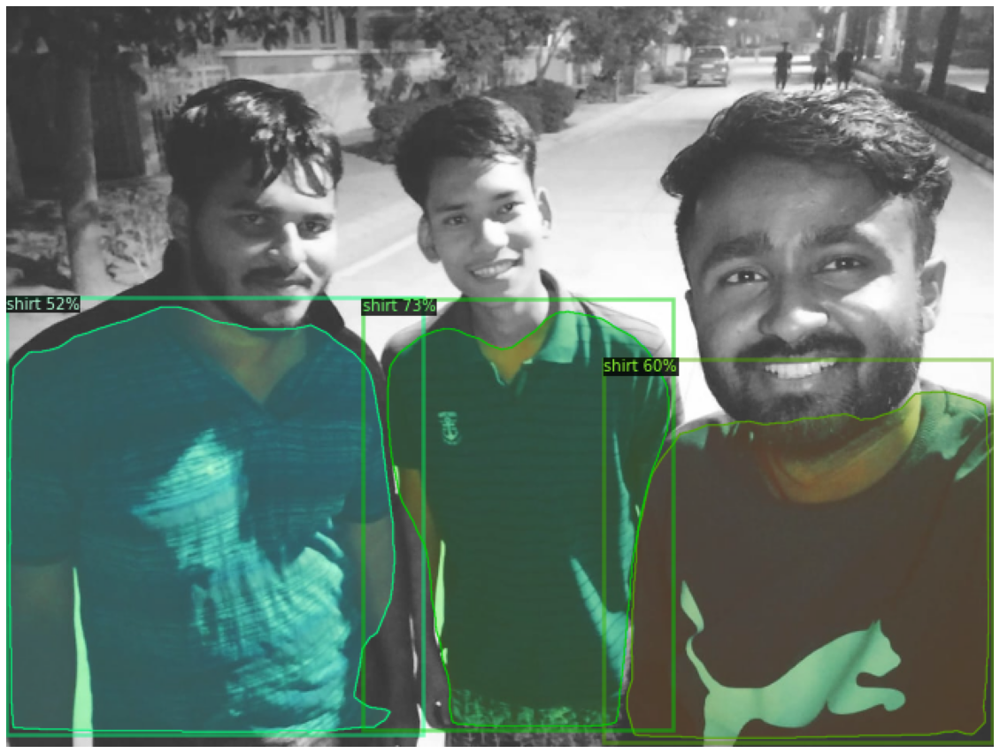

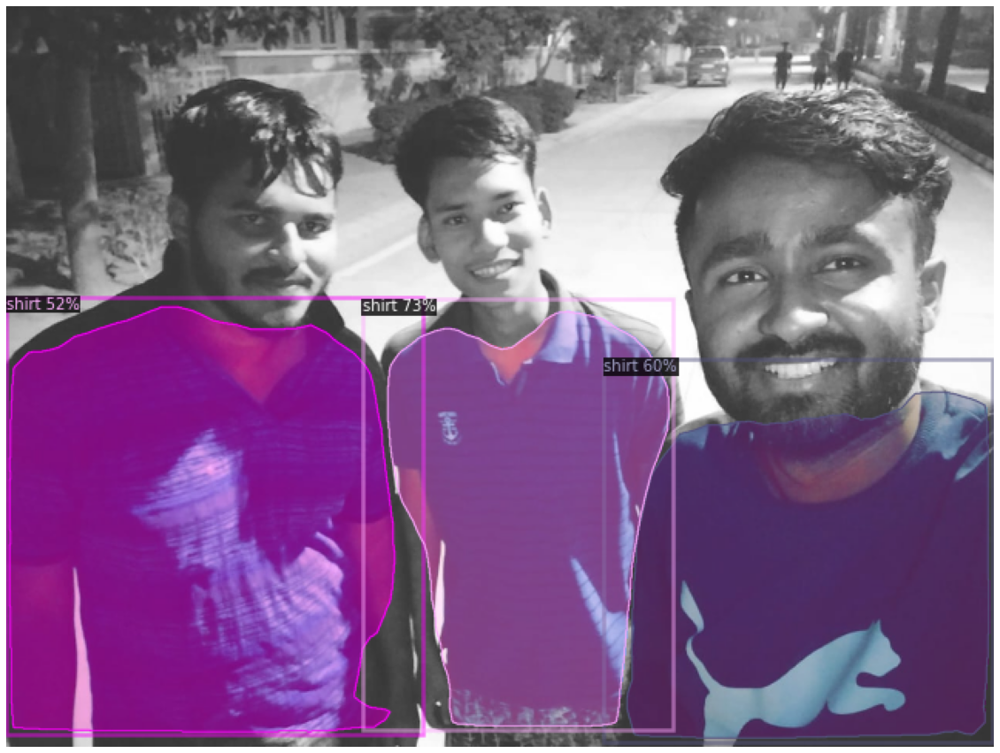

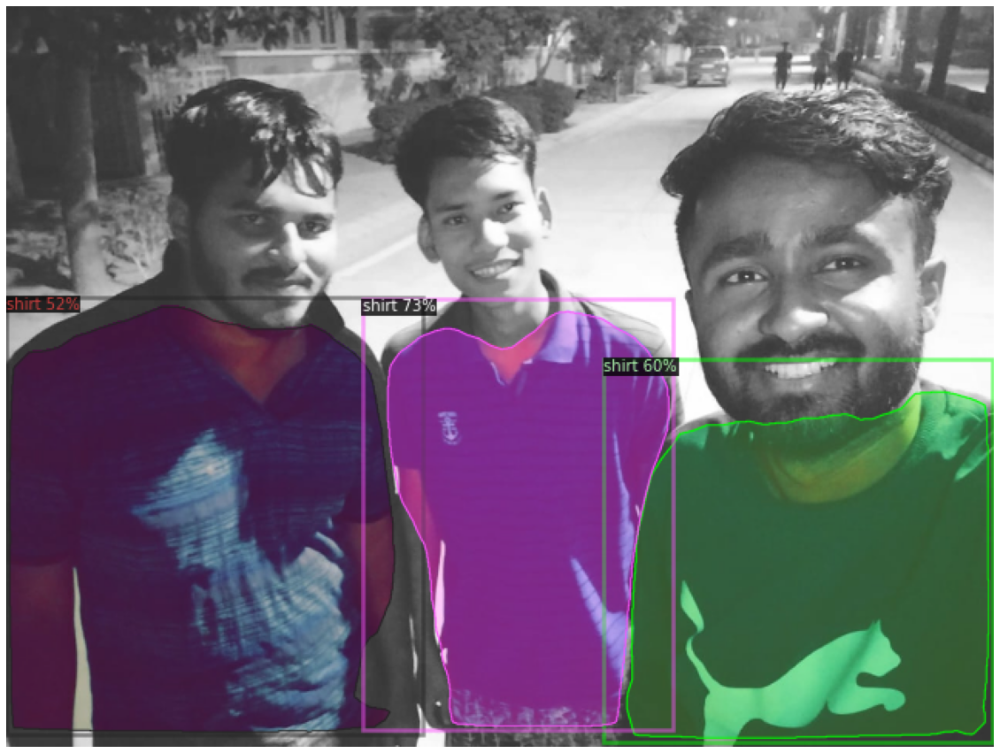

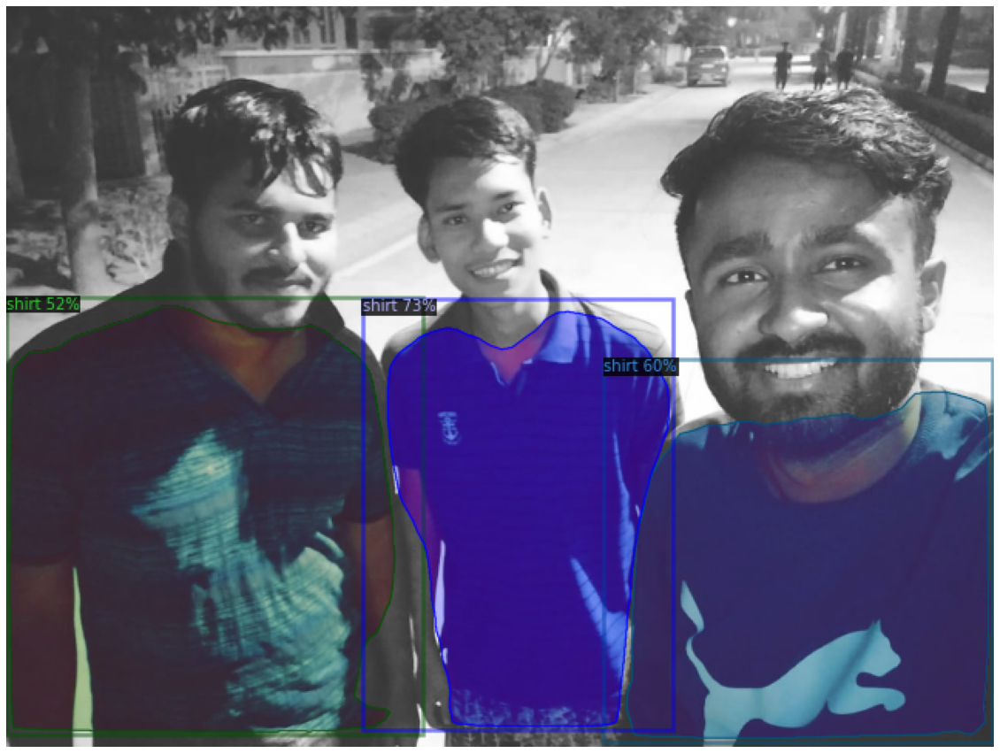

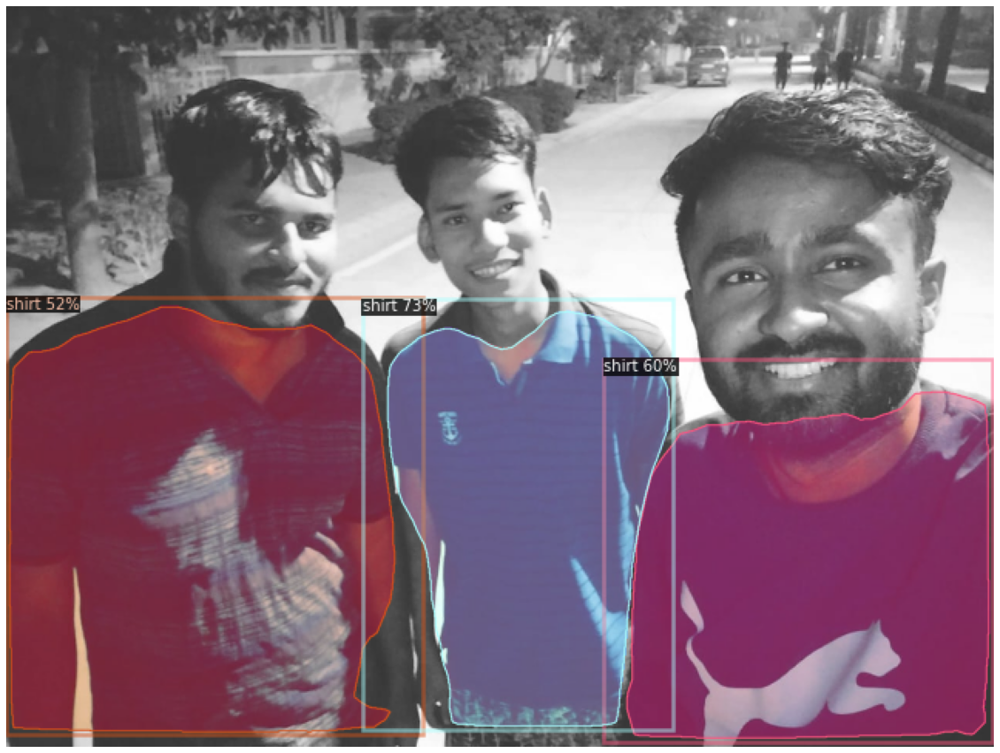

...

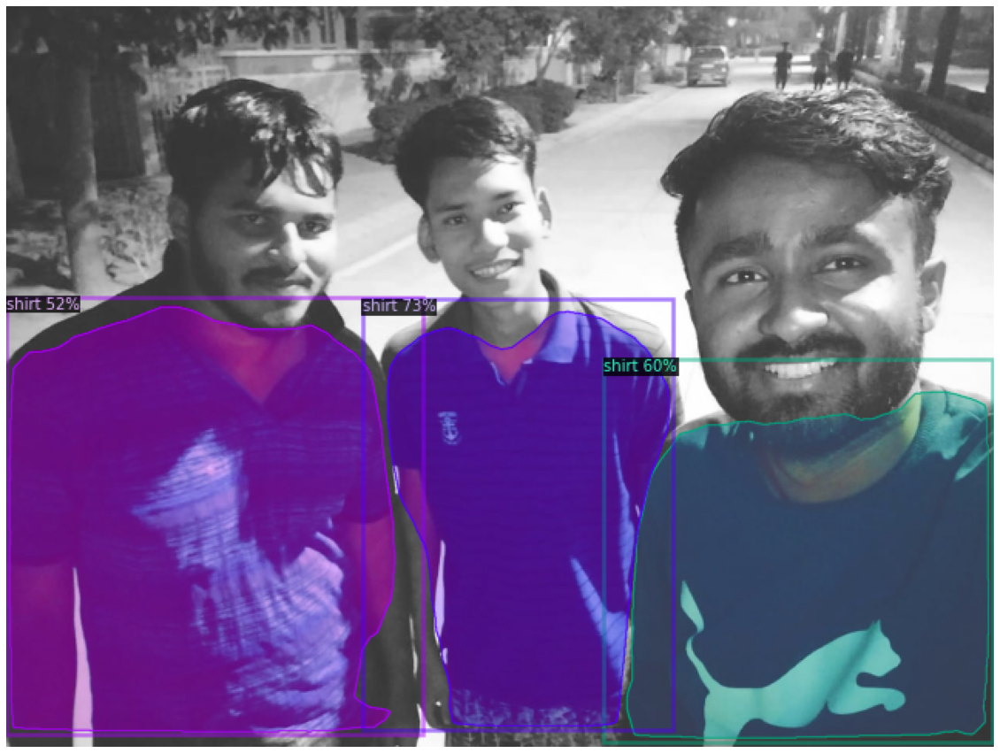

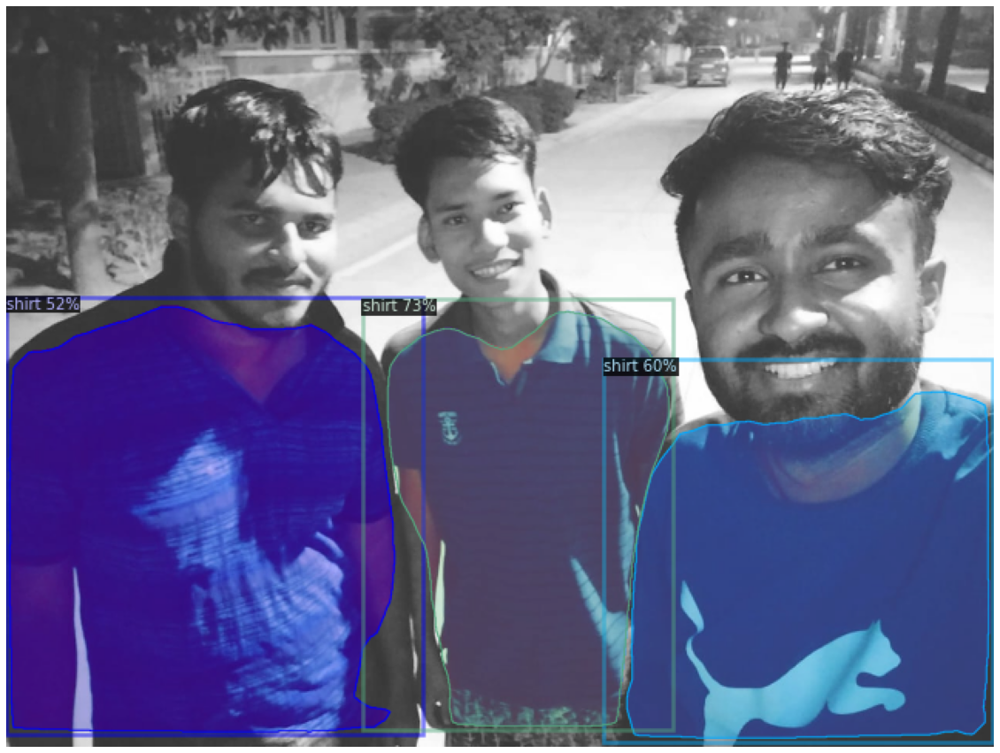

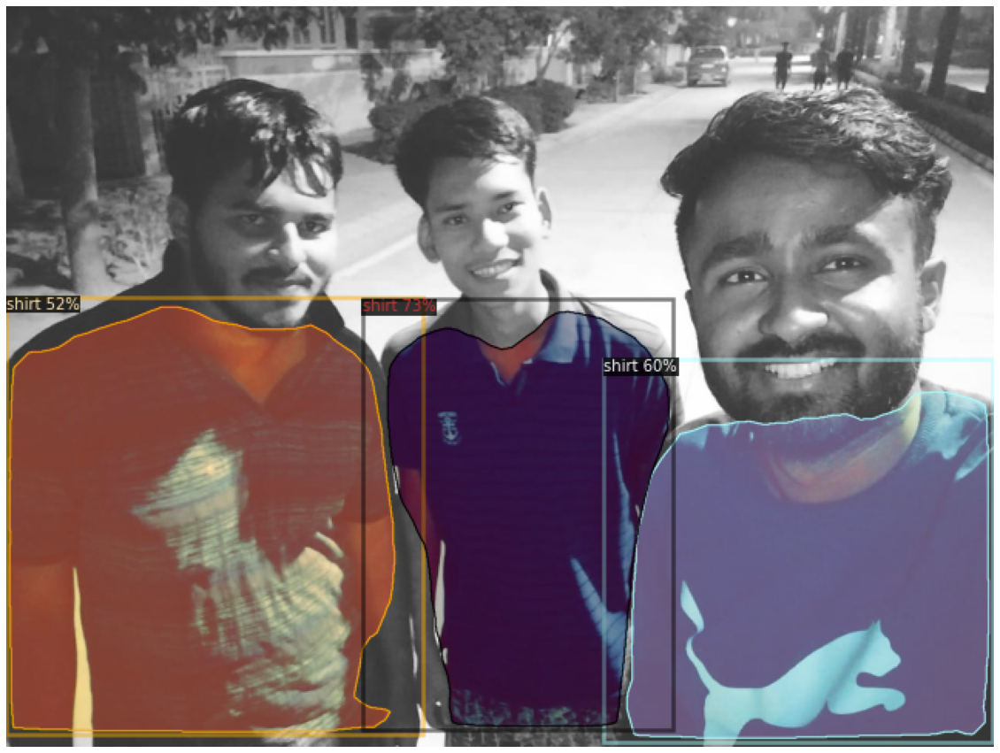

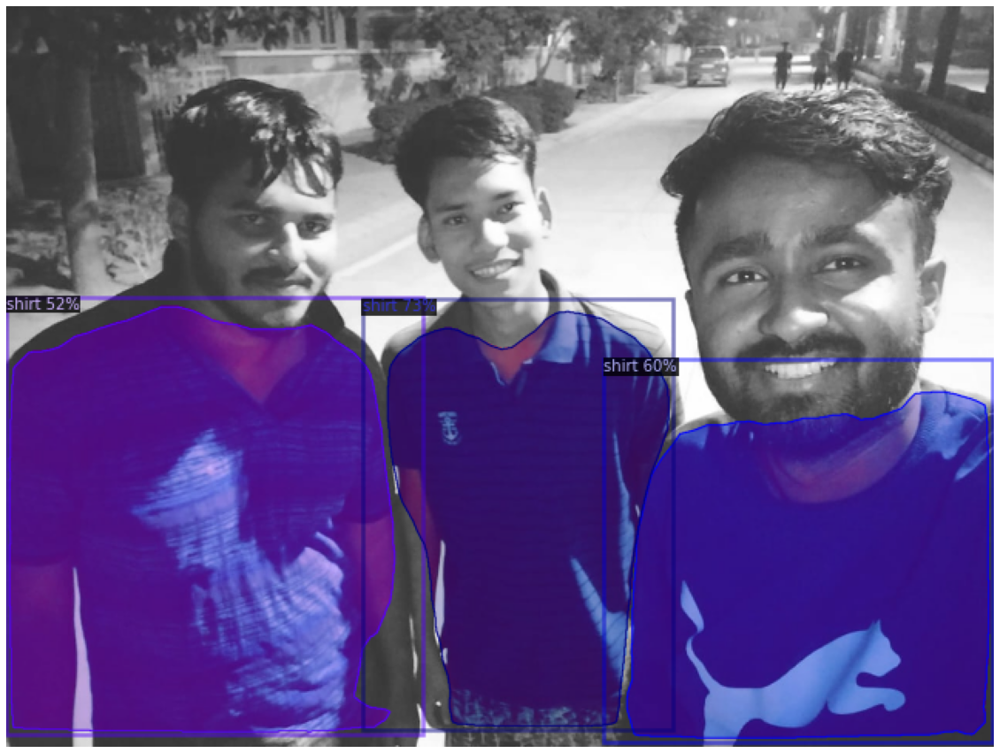

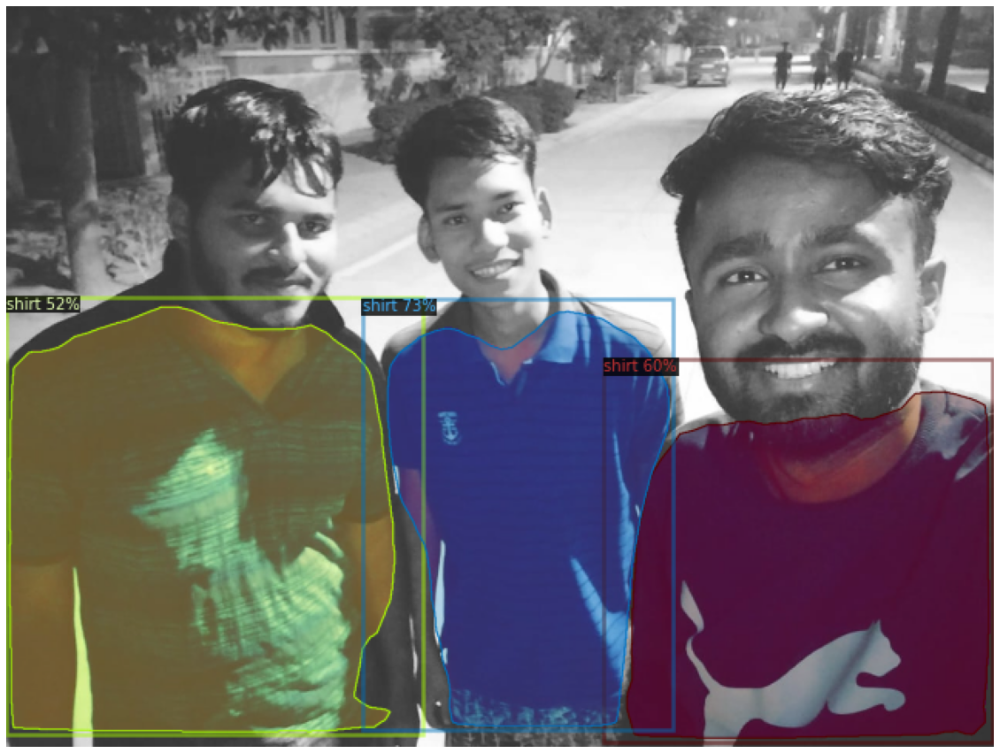

In [46]:
from detectron2.utils.visualizer import ColorMode
files = Glob('train/myData2022')
for _ in range(30):
  im = cv2.imread('/content/surya4.jpeg',1)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1], scale=0.5, metadata=MetadataCatalog.get("datasets_train"), instance_mode=ColorMode.IMAGE_BW
# remove the colors of unsegmented pixels.
# This option is only available for segmentation models
)
  out = v.draw_instance_predictions(\
  outputs["instances"].to("cpu"))
  show(out.get_image())

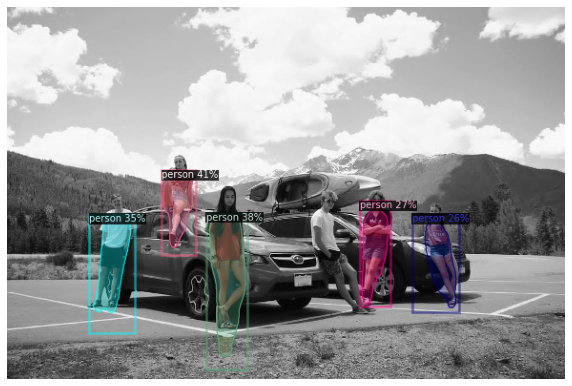

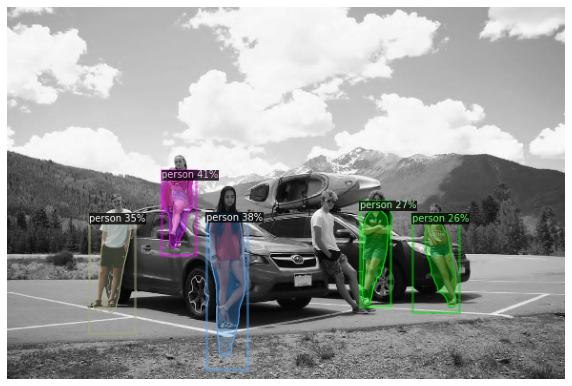

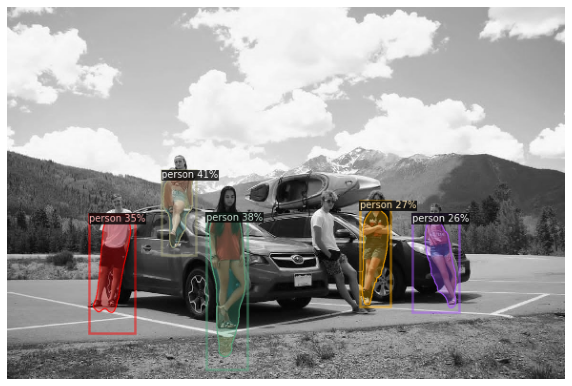

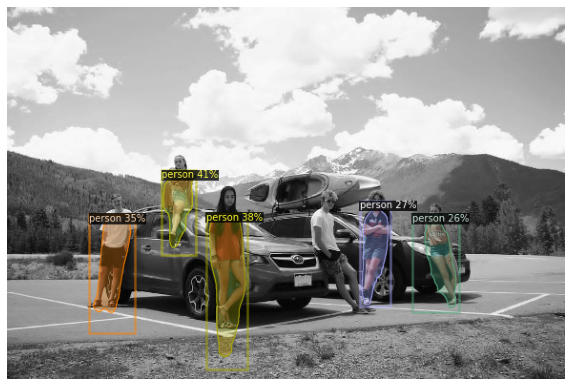

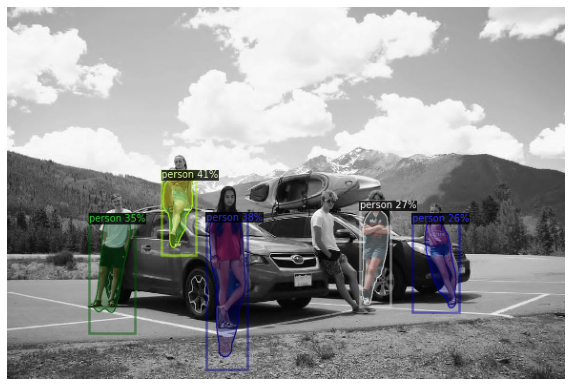

...

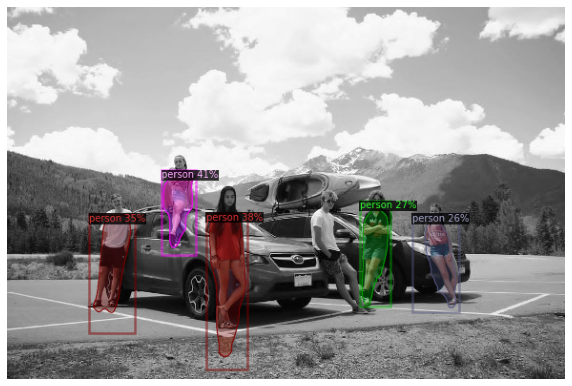

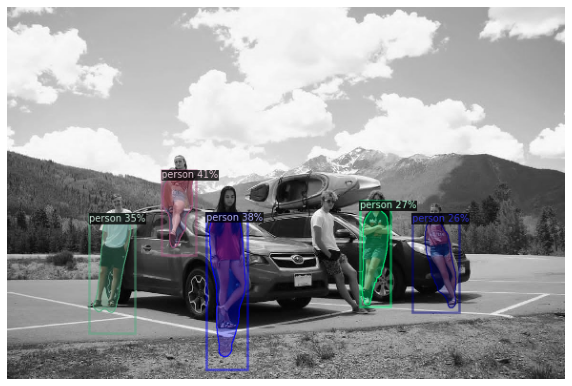

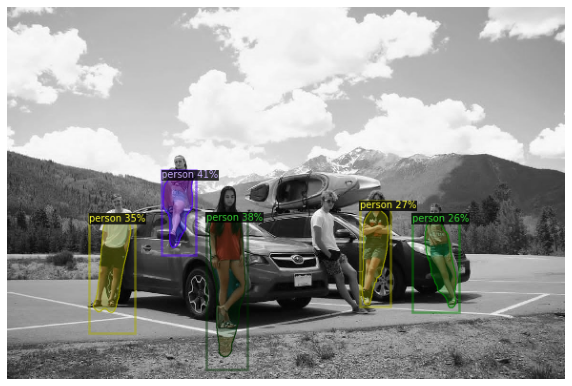

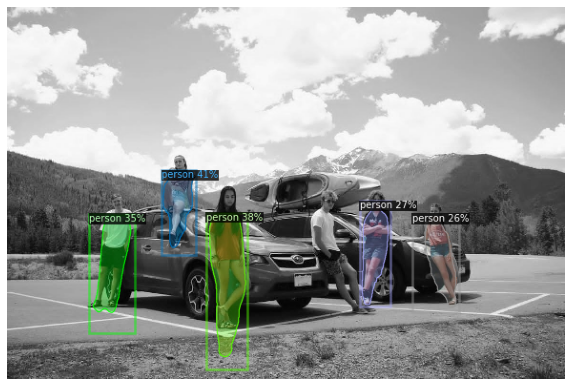

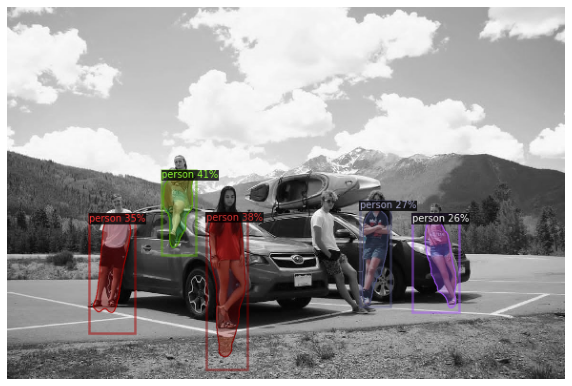

In [50]:

for _ in range(30):
  im = cv2.imread('/content/car group photo.jpeg',1)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1], scale=0.5, metadata=MetadataCatalog.get("datasets_train"), instance_mode=ColorMode.IMAGE_BW
# remove the colors of unsegmented pixels.
# This option is only available for segmentation models
)
  out = v.draw_instance_predictions(\
  outputs["instances"].to("cpu"))
  show(out.get_image())